<a href="https://colab.research.google.com/github/neehasajja/waymo-opendataset/blob/main/exploring_the_data_set/types_of_objects.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Draw the bounding box on the image with different colors for each object
    draw = ImageDraw.Draw(img)
    for obj_id, count in zip(object_ids, object_counts):
        if obj_id in [1, 2, 4]:
            label = object_mapping[obj_id]
            color = object_colors[object_mapping[obj_id]]
            print(f"{label}: {count}")

            for _, row in df_box_frame.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    # Show the image with bounding boxes
    img.show()

Vehicle: 28
Pedestrian: 51
Sign: 1
Vehicle: 28
Pedestrian: 51
Sign: 1
Vehicle: 28
Pedestrian: 51
Sign: 1
Vehicle: 28
Pedestrian: 51
Sign: 1
Vehicle: 28
Pedestrian: 51
Sign: 1


Vehicle: 28
Pedestrian: 51
Sign: 1


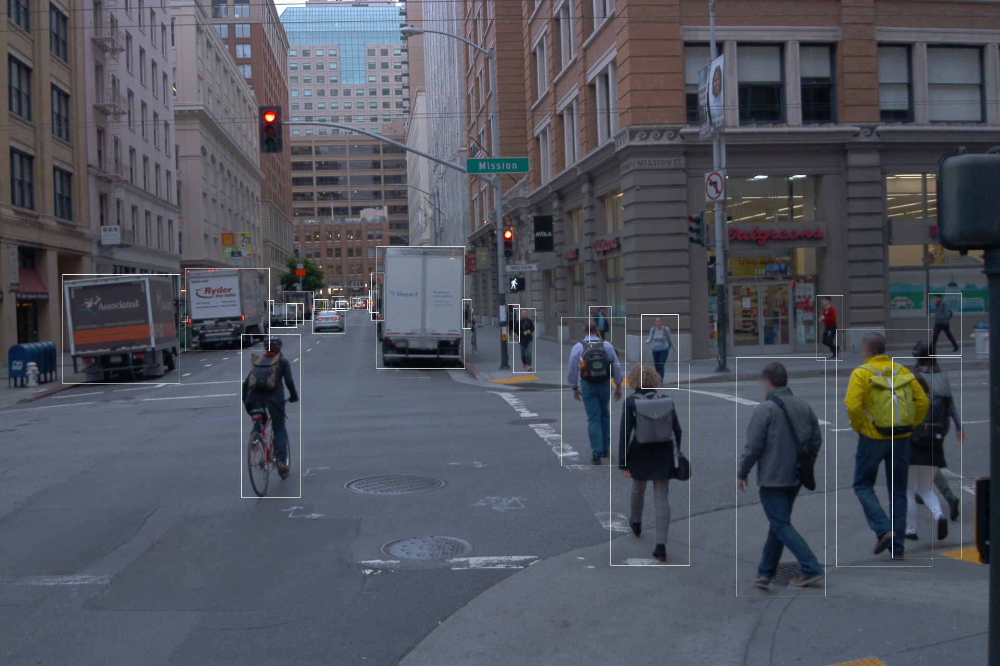

In [ ]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO
import ast

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Iterate over the object IDs and counts
for obj_id, count in zip(object_ids, object_counts):
    # Check if the object ID corresponds to vehicle, pedestrian, cyclist, or sign
    if obj_id in [1, 2, 3, 4]:
        label = object_mapping[obj_id]
        color = object_colors[label]
        print(f"{label}: {count}")

        # Draw the bounding box on the image with the assigned color
        draw = ImageDraw.Draw(img)
        for _, row in df_box_frame.iterrows():
            x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
            y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
            x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
            y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
            if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                draw.rectangle((x1, y1, x2, y2), outline=color)
                # Update color for the next bounding box
                color = 'white'  # Assign a new color for each bounding box

# Show the image with bounding boxes
img.show()

Vehicle: 28
Pedestrian: 51
Sign: 1


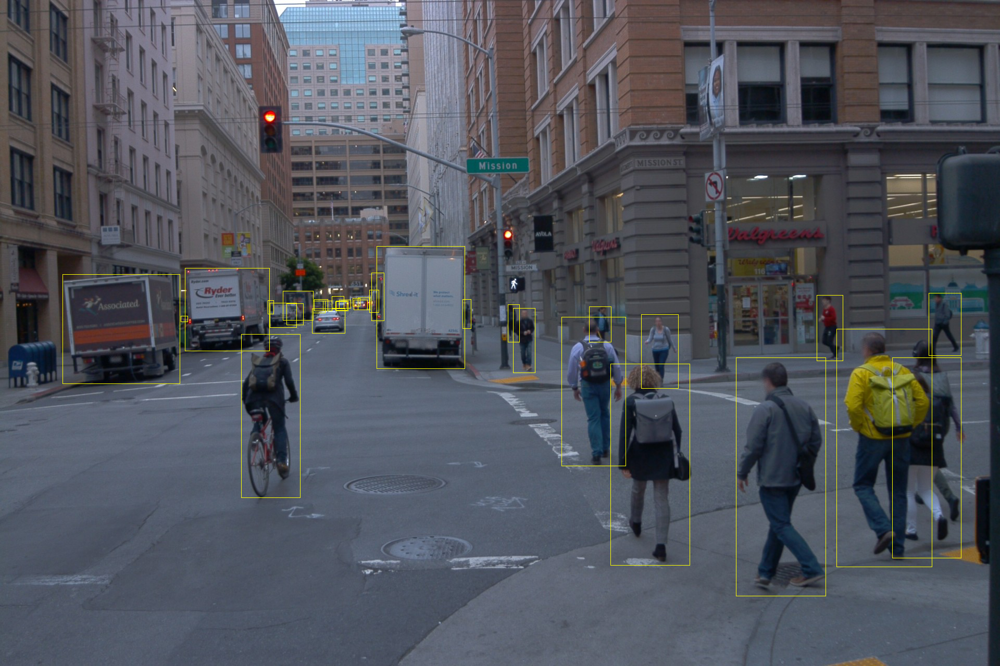

Vehicle: 28
Pedestrian: 51
Sign: 1


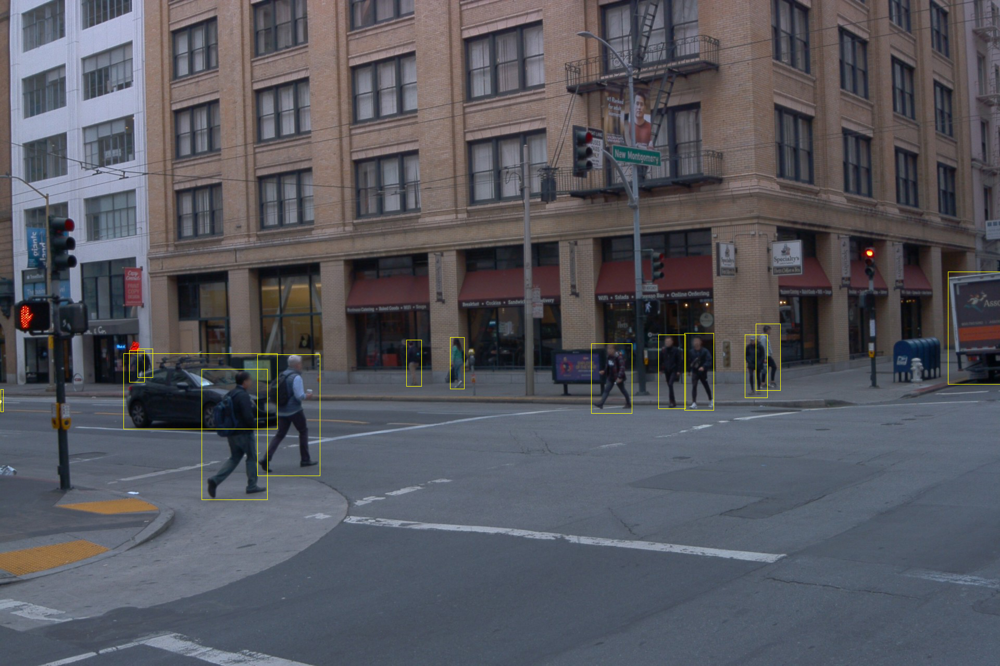

Vehicle: 28
Pedestrian: 51
Sign: 1


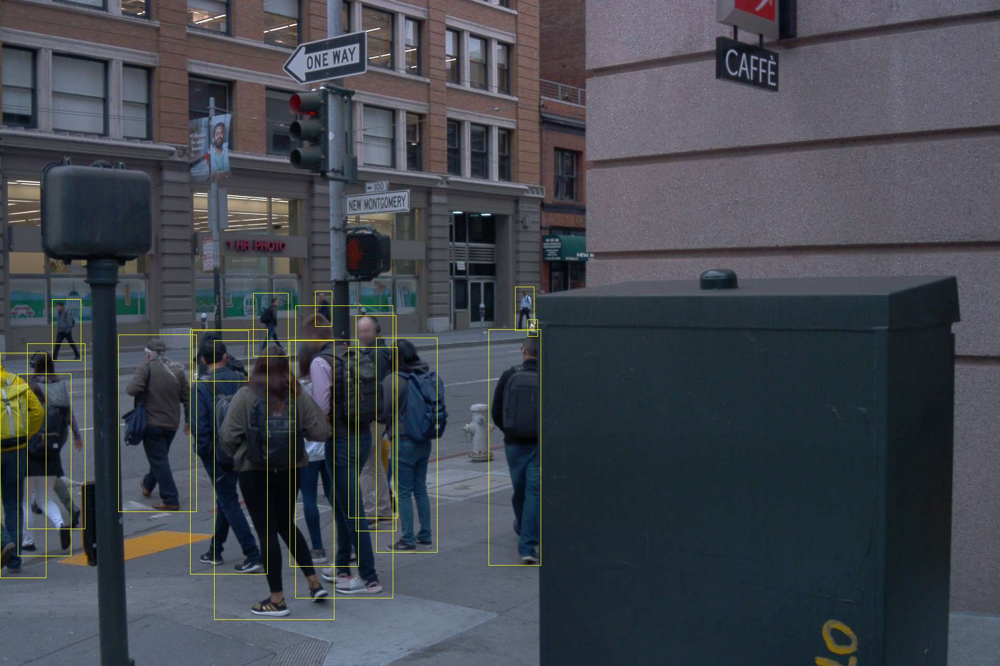

Vehicle: 28
Pedestrian: 51
Sign: 1


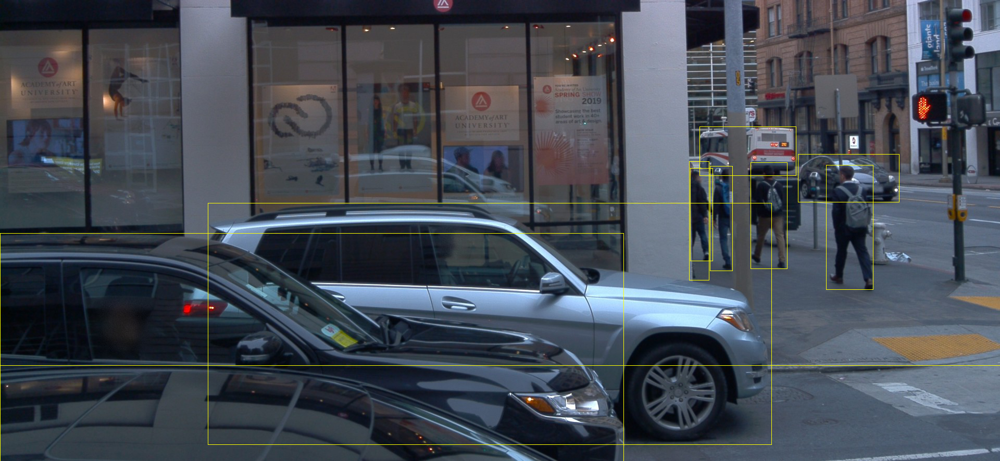

Vehicle: 28
Pedestrian: 51
Sign: 1


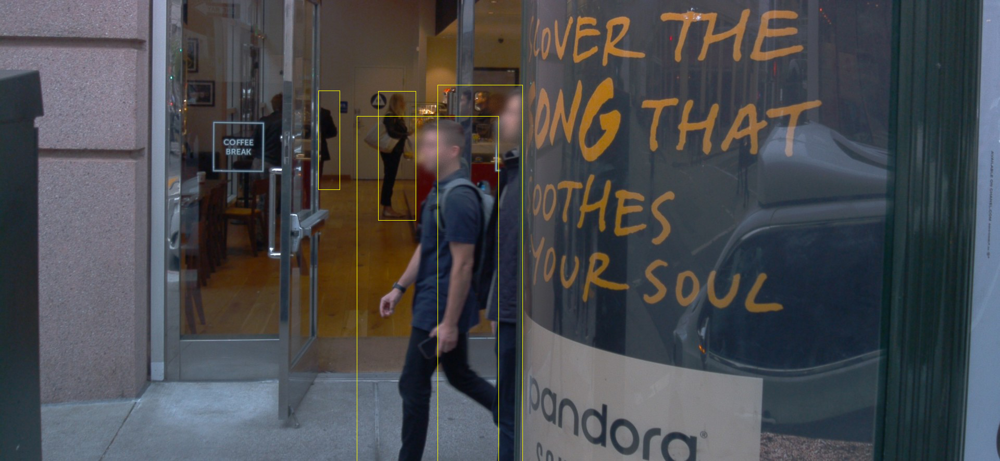

In [ ]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Iterate over the object IDs and counts
    for obj_id, count in zip(object_ids, object_counts):
        # Check if the object ID corresponds to vehicle, pedestrian, cyclist, or sign
        if obj_id in [1, 2, 3, 4]:
            label = object_mapping[obj_id]
            print(f"{label}: {count}")

            # Find the corresponding color for the current object label
            color = object_colors[label]

            # Draw the bounding box on the image with the assigned color
            draw = ImageDraw.Draw(img)
            for _, row in df_box_frame.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    # Show the image with bounding boxes
    img.show()

Vehicle: 28
Pedestrian: 51
Sign: 1


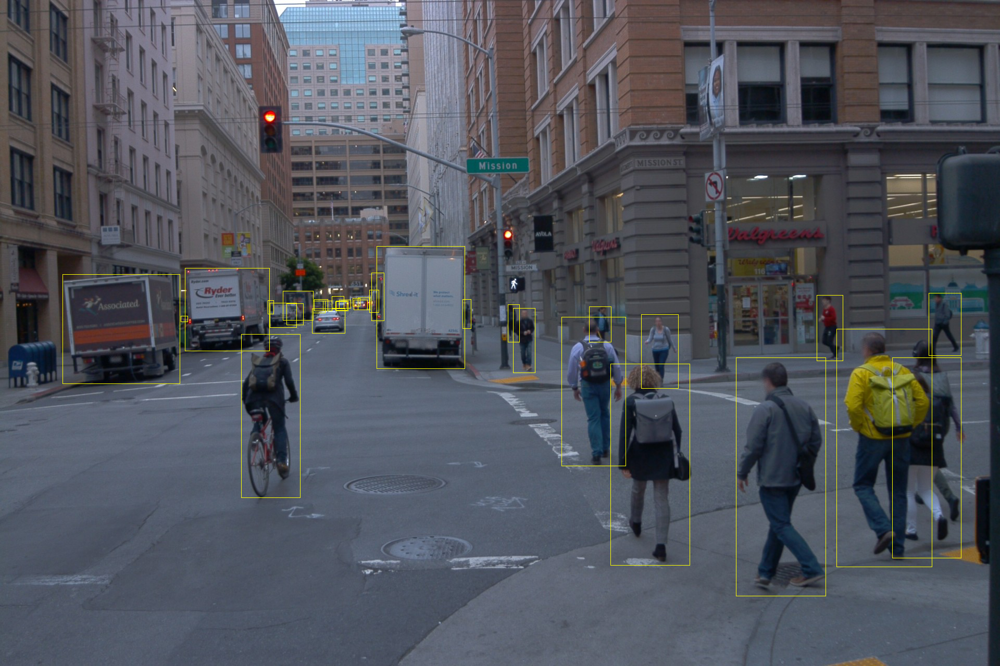

Vehicle: 28
Pedestrian: 51
Sign: 1


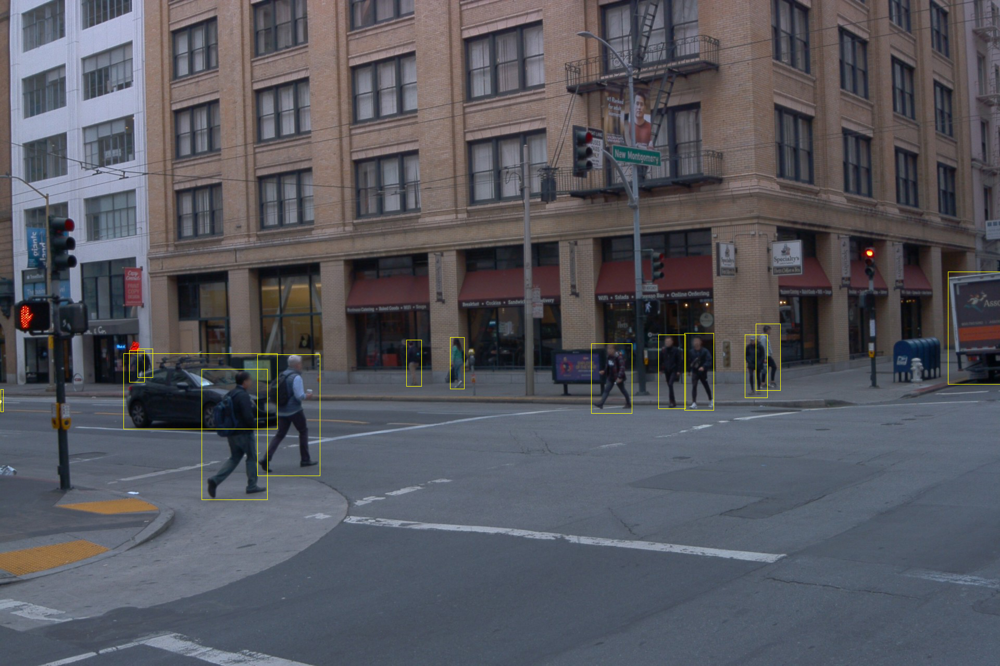

Vehicle: 28
Pedestrian: 51
Sign: 1


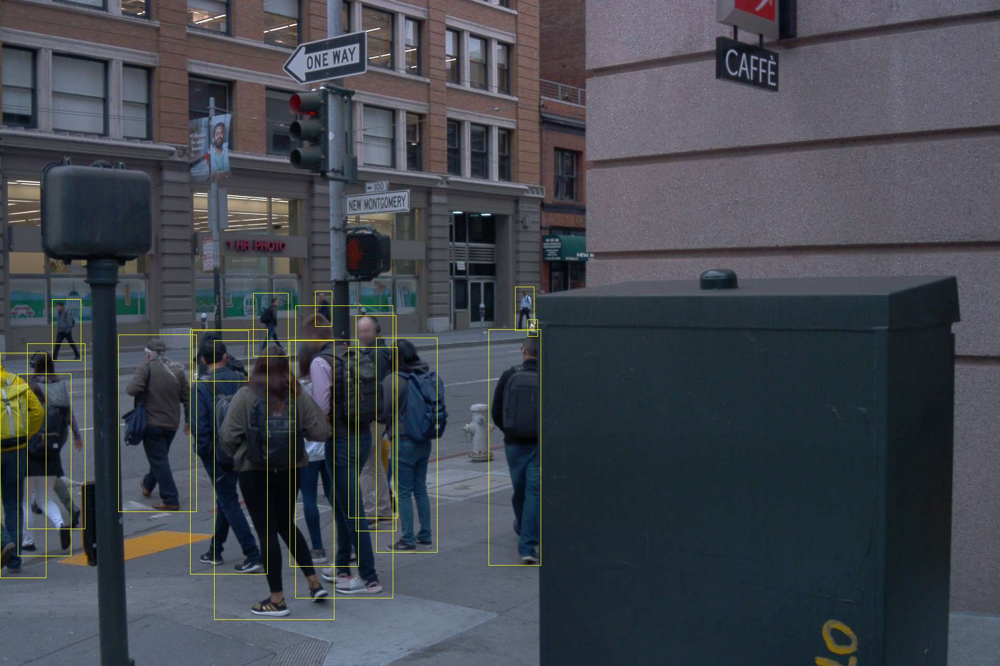

Vehicle: 28
Pedestrian: 51
Sign: 1


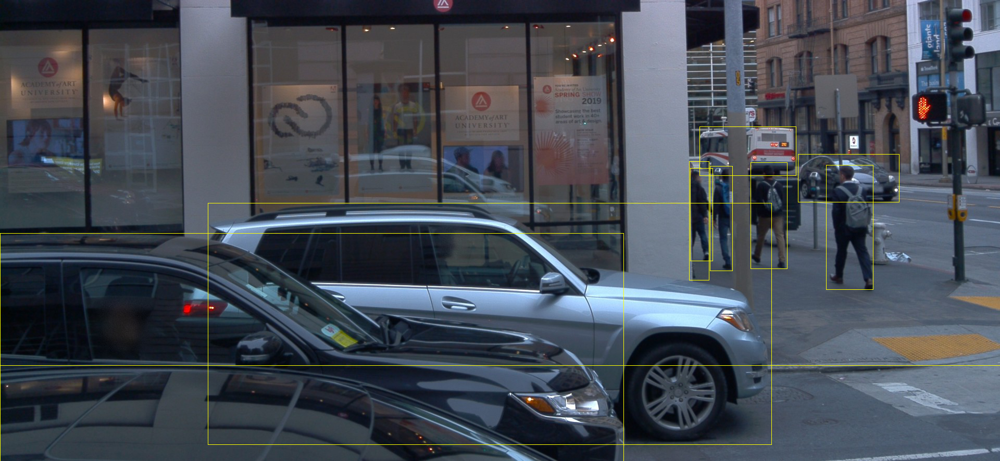

Vehicle: 28
Pedestrian: 51
Sign: 1


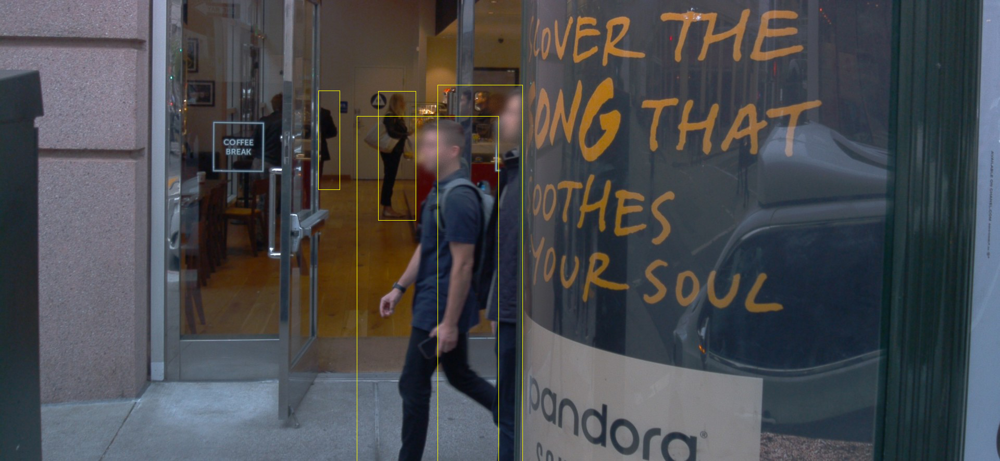

In [ ]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'RED',
    'Pedestrian': 'GREEN',
    'Cyclist': 'BLUE',
    'Sign': 'YELLOW'
}

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Iterate over the object IDs and counts
    for obj_id, count in zip(object_ids, object_counts):
        # Check if the object ID corresponds to vehicle, pedestrian, cyclist, or sign
        if obj_id in [1, 2, 3, 4]:
            label = object_mapping[obj_id]
            print(f"{label}: {count}")

            # Find the corresponding color for the current object label
            color = object_colors[label]

            # Draw the bounding box on the image with the assigned color
            draw = ImageDraw.Draw(img)
            for _, row in df_box_frame.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    # Show the image with bounding boxes
    img.show()